In [1]:
from environment import Environment, CookingStates
from agent import Agent

## Environment setup
In this section, we will create an environment according to the map in the exam instructions.

In [2]:
walls = [
    # Vertical walls between x = 0 and x = 1
    ((0, 1), (1, 1)), 
    
    
    ((0, 2), (1, 2)), 
    ((0, 3), (1, 3)), 
    ((0, 4), (1, 4)),

    # Vertical walls between x = 1 and x = 2
    ((1, 3), (2, 3)),

    # Vertical walls between x = 4 and x = 5
    ((4, 1), (5, 1)), ((4, 2), (5, 2)), ((4, 3), (5, 3)), ((4, 4), (5, 4)),

    # Vertical walls between x = 5 and x = 6
    ((5, 1), (6, 1)), ((5, 2), (6, 2)), ((5, 3), (6, 3)), ((5, 4), (6, 4)),

    # Vertical walls between x = 7 and x = 8
    ((7, 2), (8, 2)), ((7, 3), (8, 3)),

    # Vertical walls between x = 9 and x = 10
    ((9, 1), (10, 1)), ((9, 2), (10, 2)), ((9, 3), (10, 3)), ((9, 4), (10, 4)),

    # Horizontal walls between y = 0 and y = 1
    ((1, 0), (1, 1)), ((2, 0), (2, 1)), ((3, 0), (3, 1)), ((4, 0), (4, 1)), ((
        6, 0), (6, 1)), ((7, 0), (7, 1)), ((8, 0), (8, 1)), ((9, 0), (9, 1)),

    # Horizontal walls between y = 1 and y = 2
    ((1, 1), (1, 2)), ((2, 1), (2, 2)), ((3, 1), (3, 2)), ((8, 1), (8, 2)),

    # Horizontal walls between y = 2 and y = 3
    ((2, 2), (2, 3)), ((3, 2), (3, 3)),

    # Horizontal walls between y = 3 and y = 4
    ((1, 3), (1, 4)), ((8, 3), (8, 4)), ((9, 3), (9, 4)),

    # Horizontal walls between y = 4 and y = 5
    ((1, 4), (1, 5)), ((2, 4), (2, 5)), ((3, 4), (3, 5)), ((4, 4), (4, 5)), ((
        6, 4), (6, 5)), ((7, 4), (7, 5)), ((8, 4), (8, 5)), ((9, 4), (9, 5)),

]

out_of_map = [(5, y) for y in range(1, 5)]

In [3]:
env = Environment(map_width=9, map_height=4, walls=walls, frying_pans=[
                  (1, 4)], ovens=[(8, 4)], egg_beaters=[(1, 3), (8, 3)], gates=[(4, 2), (9, 3)], out_of_map_points=out_of_map, save_spreadsheet=False)



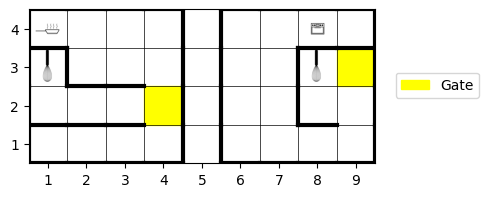

In [4]:
env.draw_map()

In [5]:
env.policy_iteration_matrix()

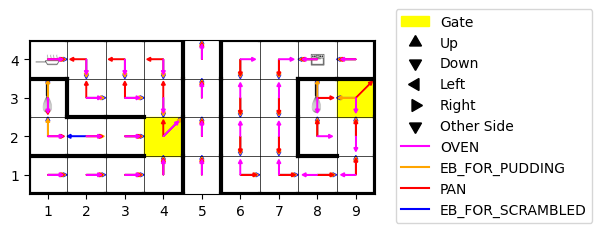

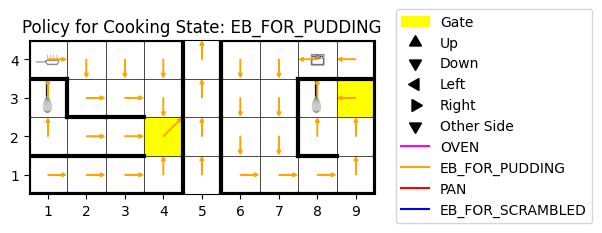

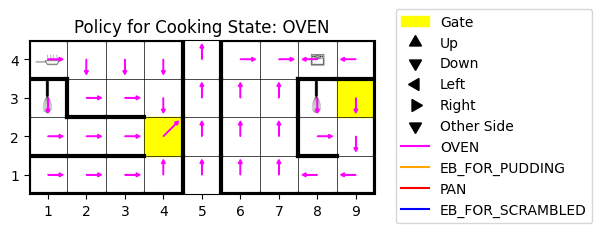

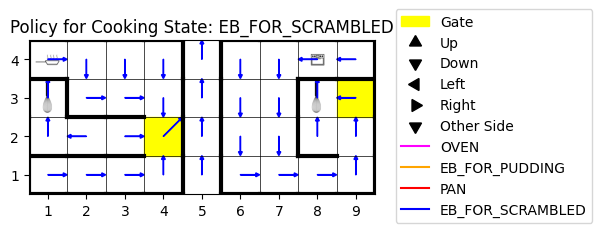

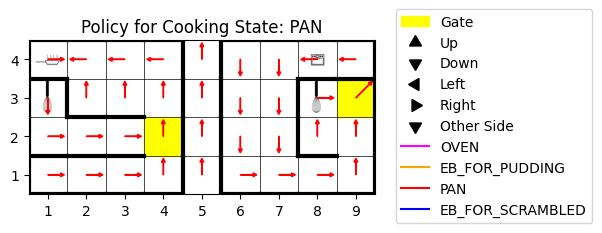

In [6]:
env.draw_map(env.policy)
env.draw_map(env.policy, cooking_state_for_plc=CookingStates.EB_FOR_PUDDING)
env.draw_map(env.policy, cooking_state_for_plc=CookingStates.OVEN)
env.draw_map(env.policy, cooking_state_for_plc=CookingStates.EB_FOR_SCRAMBLED)
env.draw_map(env.policy, cooking_state_for_plc=CookingStates.PAN)

## Execution of Scrambled Eggs Simulation

This section presents the execution results for the variations of the Monte Carlo algorithm, including both cases: with epsilon-greedy exploration and without epsilon-based exploration.

The episodes are generated using `(4, 3)` as the spawn point, as specified in the instructions. In the subsequent section, the policy will be calculated using a random spawn point for comparison.


In [7]:
agent = Agent(env, recipe="pudding", spawn_point=None)



Episode 1 started from (6, 4, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 1 (eps: 0.1): exploration: 13, exploitation: 97


Episode 2 started from (4, 2, <CookingStates.OVEN: 3>)
Policy changes for episode 2 (eps: 0.8408964152537146): exploration: 92, exploitation: 5


Episode 3 started from (3, 1, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 3 (eps: 0.7598356856515925): exploration: 84, exploitation: 25


Episode 4 started from (8, 2, <CookingStates.OVEN: 3>)
Policy changes for episode 4 (eps: 0.7071067811865475): exploration: 78, exploitation: 25


Episode 5 started from (7, 2, <CookingStates.OVEN: 3>)
Policy changes for episode 5 (eps: 0.668740304976422): exploration: 69, exploitation: 35


Episode 6 started from (1, 2, <CookingStates.OVEN: 3>)
Policy changes for episode 6 (eps: 0.6389431042462724): exploration: 60, exploitation: 32


Episode 7 started from (4, 3, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 7 (eps: 0.61478815295

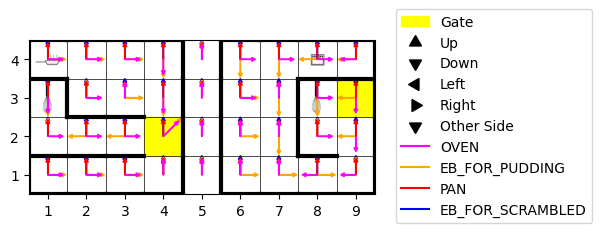

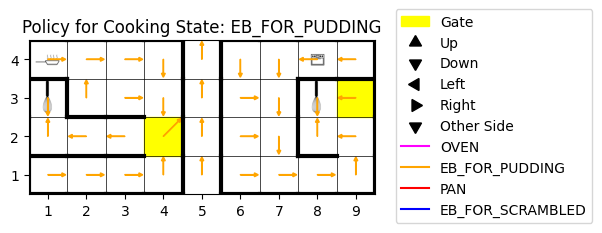

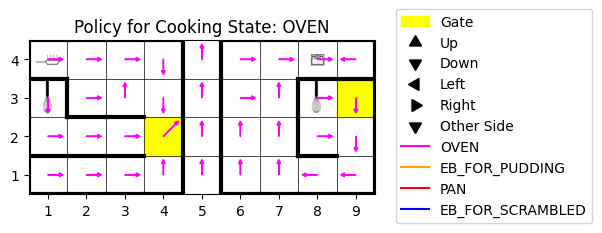

In [8]:
agent.incremental_mc_epsilon_greedy()
env.draw_map(agent.policy)
env.draw_map(agent.policy, cooking_state_for_plc=CookingStates.EB_FOR_PUDDING)
env.draw_map(agent.policy, cooking_state_for_plc=CookingStates.OVEN)


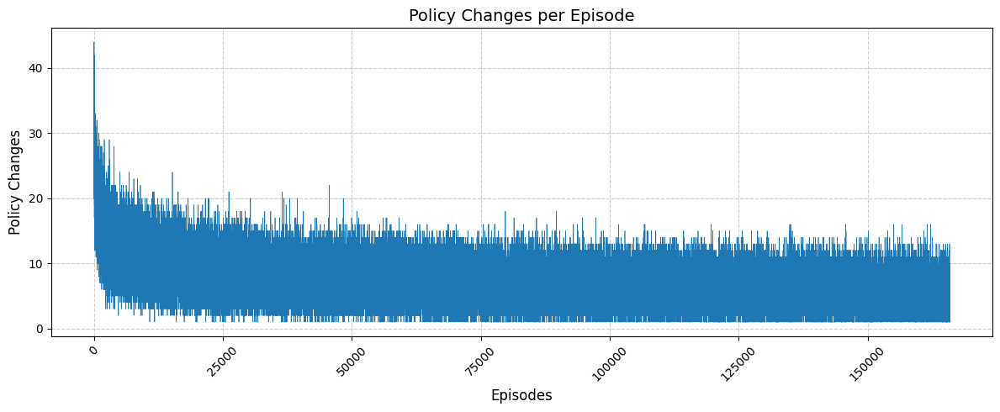

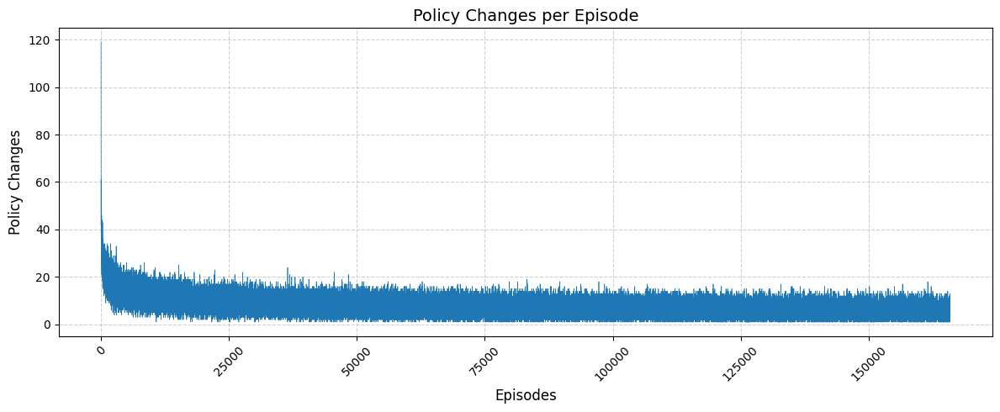

In [7]:
import matplotlib.pyplot as plt

# Extract keys and values
x_values = list(agent.statistics["policy_changes"]["exploitation"].keys())
y_values = list(agent.statistics["policy_changes"]["exploitation"].values())

# Plotting
plt.figure(figsize=(12, 5))
plt.plot(x_values, y_values, linestyle='-', linewidth=0.5)
plt.xlabel('Episodes', fontsize=12)
plt.ylabel('Policy Changes', fontsize=12)
plt.title('Policy Changes per Episode', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


# Extract keys and values
x_values = list(agent.statistics["policy_changes"]["exploration"].keys())
y_values = list(agent.statistics["policy_changes"]["exploration"].values())

# Plotting
plt.figure(figsize=(12, 5))
plt.plot(x_values, y_values, linestyle='-', linewidth=0.5)
plt.xlabel('Episodes', fontsize=12)
plt.ylabel('Policy Changes', fontsize=12)
plt.title('Policy Changes per Episode', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

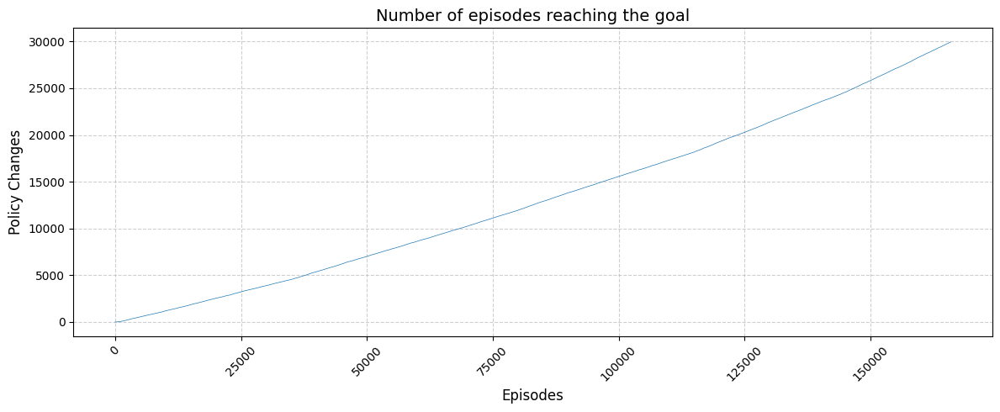

In [8]:
import matplotlib.pyplot as plt

# Extract keys and values
x_values = list(agent.statistics["goal_rate"]["successes"].keys())
y_values = list(agent.statistics["goal_rate"]["successes"].values())

# Plotting
plt.figure(figsize=(12, 5))
plt.plot(x_values, y_values, linestyle='-', linewidth=0.5)
plt.xlabel('Episodes', fontsize=12)
plt.ylabel('Policy Changes', fontsize=12)
plt.title('Number of episodes reaching the goal', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


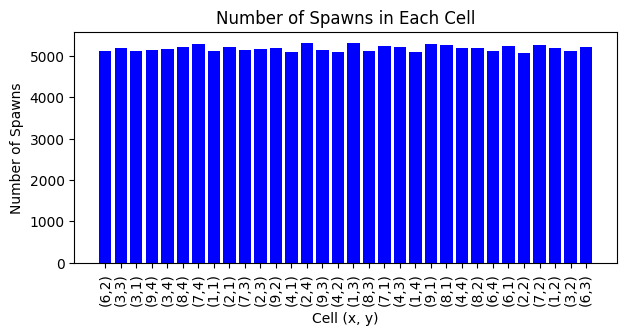

In [9]:
import matplotlib.pyplot as plt

# Extract spawn points statistics
spawn_points = env.statistics["spawn_points"]

# Prepare data for plotting
x = [f"({x},{y})" for (x, y) in spawn_points.keys()]
y = [count for count in spawn_points.values()]

# Plot the column chart
plt.figure(figsize=(7, 3))
plt.bar(x, y, color='blue')
plt.xlabel('Cell (x, y)')
plt.ylabel('Number of Spawns')
plt.title('Number of Spawns in Each Cell')
plt.xticks(rotation=90)
plt.show()

#### Graphical Representation of Rewards per Cooking State

This subsection provides a graphical representation of the rewards for each `CookingState`. As illustrated, each cell imposes a penalty of `-1` to discourage longer paths. In contrast, goal cells provide a reward that increases based on the cooking phase. Advanced cooking phases correspond to higher rewards, reflecting the incremental progression toward completing the task.

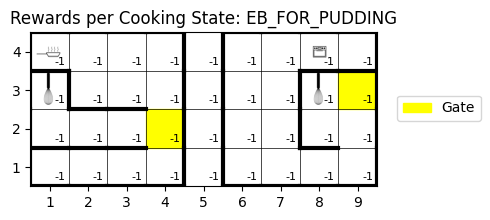

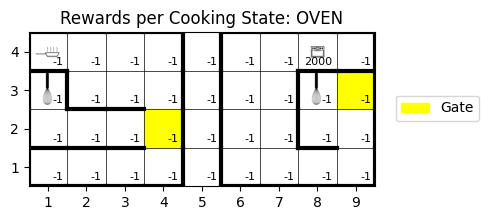

In [10]:
env.draw_map(cooking_state_for_rw=CookingStates.EB_FOR_PUDDING)
env.draw_map(cooking_state_for_rw=CookingStates.OVEN)

## Execution of Scrambled Eggs Simulation with single spawn

In this section, the simulation is executed using a randomly selected spawn point for the agent, adding variability to the starting conditions. This approach allows for a broader exploration of the environment and helps evaluate the algorithm's adaptability to different initial states.

While this approach might seem unnecessary for such a small map, it could prove beneficial when applied to larger, more complex environments, where adaptability is crucial for effective learning.


In [ ]:
# env_rand_sp = Environment(map_width=9, map_height=4, walls=walls, frying_pans=[
#                   (1, 4)], ovens=[(8, 4)], egg_beaters=[(1, 3), (8, 3)], gates=[(4, 2), (9, 3)], out_of_map_points=out_of_map)

agent_rand_sp = Agent(env, recipe="pudding", spawn_point=(4,3))

agent_rand_sp.incremental_mc_epsilon_greedy()
env.draw_map(agent_rand_sp.policy)
env.draw_map(agent_rand_sp.policy, cooking_state_for_plc=CookingStates.EB_FOR_PUDDING)
env.draw_map(agent_rand_sp.policy, cooking_state_for_plc=CookingStates.OVEN)



Episode 1 started from (4, 3, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 1 (eps: 1): exploration: 116, exploitation: 0


Episode 2 started from (4, 3, <CookingStates.OVEN: 3>)
Policy changes for episode 2 (eps: 0.8408964152537146): exploration: 98, exploitation: 19


Episode 3 started from (4, 3, <CookingStates.OVEN: 3>)
Policy changes for episode 3 (eps: 0.7598356856515925): exploration: 88, exploitation: 25


Episode 4 started from (4, 3, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 4 (eps: 0.7071067811865475): exploration: 89, exploitation: 23


Episode 5 started from (4, 3, <CookingStates.OVEN: 3>)
Policy changes for episode 5 (eps: 0.668740304976422): exploration: 76, exploitation: 30


Episode 6 started from (4, 3, <CookingStates.OVEN: 3>)
Policy changes for episode 6 (eps: 0.6389431042462724): exploration: 81, exploitation: 28


Episode 7 started from (4, 3, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 7 (eps: 0.614788152951

## Both Recipes

In this section, the policy is calculated independently of the spawn point or the specific recipe. The agent demonstrates the ability to execute a recipe regardless of its type or the initial spawn location. This highlights the adaptability and scalability of the approach, showcasing its potential for handling dynamic and diverse scenarios effectively.




Episode 1 started from (6, 3, <CookingStates.EB_FOR_SCRAMBLED: 0>)
Policy changes for episode 1 (eps: 1): exploration: 118, exploitation: 0


Episode 2 started from (2, 2, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 2 (eps: 0.8122523963562355): exploration: 85, exploitation: 27


Episode 3 started from (3, 3, <CookingStates.OVEN: 3>)
Policy changes for episode 3 (eps: 0.7192230933248644): exploration: 83, exploitation: 22


Episode 4 started from (2, 3, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 4 (eps: 0.6597539553864472): exploration: 77, exploitation: 25


Episode 5 started from (1, 2, <CookingStates.EB_FOR_PUDDING: 1>)
Policy changes for episode 5 (eps: 0.6170338627200096): exploration: 69, exploitation: 26


Episode 6 started from (9, 1, <CookingStates.PAN: 2>)
Policy changes for episode 6 (eps: 0.5841906810678655): exploration: 68, exploitation: 29


Episode 7 started from (3, 2, <CookingStates.EB_FOR_SCRAMBLED: 0>)
Policy changes for episod

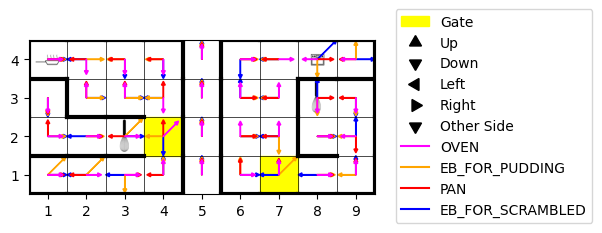

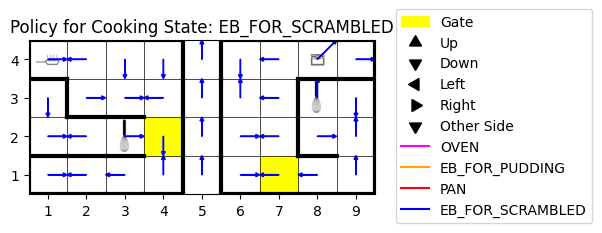

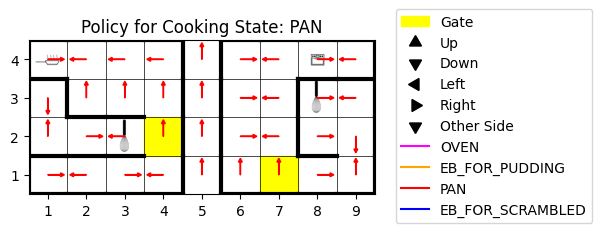

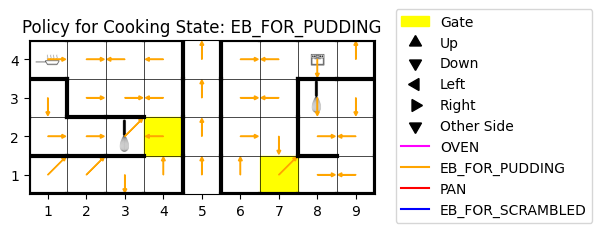

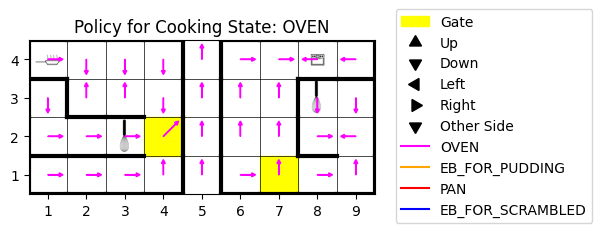

In [3]:
env_both = Environment(map_width=9, map_height=4, walls=walls, frying_pans=[
                  (1, 4)], ovens=[(8, 4)], egg_beaters=[(3, 2), (8, 3)], gates=[(4, 2), (7, 1)], out_of_map_points=out_of_map)
agent_both = Agent(env_both, recipe="both", spawn_point=None)
agent_both.incremental_mc_epsilon_greedy()
env_both.draw_map(agent_both.policy)
env_both.draw_map(agent_both.policy, cooking_state_for_plc=CookingStates.EB_FOR_SCRAMBLED)
env_both.draw_map(agent_both.policy, cooking_state_for_plc=CookingStates.PAN)
env_both.draw_map(agent_both.policy, cooking_state_for_plc=CookingStates.EB_FOR_PUDDING)
env_both.draw_map(agent_both.policy, cooking_state_for_plc=CookingStates.OVEN)